In [1]:
import os
import glob
import sys
sys.path.append('/Users/aghavamp/Desktop/Projects')
sys.path.append('/Users/aghavamp/Desktop/Projects/bimanual_wrist')
sys.path.append('/Users/aghavamp/Desktop/Projects/Functional_Fusion')
sys.path.append('/Users/aghavamp/Desktop/Projects/AnatSearchlight')

sys.path.append('/Users/aghavamp/Desktop/Projects/PcmPy')
import getpass
import importlib
from tqdm import tqdm
from pathlib import Path

import AnatSearchlight.searchlight as sl
import rsatoolbox as rsa
from rsatoolbox.io import spm as spm_io
import nibabel as nb
import nitools as nt
import PcmPy as pcm
import Functional_Fusion.atlas_map as am
import Functional_Fusion.reliability as rel

import matplotlib.pyplot as plt
import matplotlib
from matplotlib.cm import ScalarMappable
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import matplotlib.patches as patches
import seaborn as sns

import scipy.io as sio
import numpy as np
import pandas as pd

import utils
importlib.reload(utils)

# SET PATHS:
baseDir = os.path.join('/Users', getpass.getuser(), 'Desktop', 'Projects', 'bimanual_wrist', 'data', 'fMRI')
bidsDir = 'BIDS'
anatomicalDir = 'anatomicals'
freesurferDir = 'surfaceFreesurfer'
surfacewbDir = 'surfaceWB' 
behavDir = 'behavioural'
regDir = 'ROI'
atlasDir = '/Volumes/diedrichsen_data$/data/Atlas_templates/fs_LR_32'
analysisDir = os.path.join(os.path.dirname(os.path.dirname(baseDir)), 'analysis')



## Define searchlight

In [2]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']
radius = 30
maxvoxels = 200

for sn in sn_list:
    try:
        # define:
        for i, h in enumerate(hem):
            mySearchlight = sl.SearchlightSurface(sl_name[i])
            surfaces = [os.path.join(baseDir, surfacewbDir, f's{sn}', f's{sn}.{h}.pial.32k.surf.gii'),
                        os.path.join(baseDir, surfacewbDir, f's{sn}', f's{sn}.{h}.white.32k.surf.gii')]
            mask = os.path.join(baseDir, f'glm{glm}', f's{sn}', 'mask.nii') # Mask in functional space for the subject
            
            # search light define:
            mySearchlight.define(surfaces,mask,maxradius=radius,maxvoxels=maxvoxels)
            mySearchlight.save(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
    
    except Exception as e:
        print(f"Error processing subject {sn}, hemisphere {h}: {e}")
        continue






Processing center 0 of 32492
Processing center 1000 of 32492
Processing center 2000 of 32492
Processing center 3000 of 32492
Processing center 4000 of 32492
Processing center 5000 of 32492
Processing center 6000 of 32492
Processing center 7000 of 32492
Processing center 8000 of 32492
Processing center 9000 of 32492
Processing center 10000 of 32492
Processing center 11000 of 32492
Processing center 12000 of 32492
Processing center 13000 of 32492
Processing center 14000 of 32492
Processing center 15000 of 32492
Processing center 16000 of 32492
Processing center 17000 of 32492
Processing center 18000 of 32492
Processing center 19000 of 32492
Processing center 20000 of 32492
Processing center 21000 of 32492
Processing center 22000 of 32492
Processing center 23000 of 32492
Processing center 24000 of 32492
Processing center 25000 of 32492
Processing center 26000 of 32492
Processing center 27000 of 32492
Processing center 28000 of 32492
Processing center 29000 of 32492
Processing center 30000

## Run mean beta searchlight

In [2]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']
conds = ['lhand', 'rhand', 'bi']

def mean_function(data):
    # mean_voxels = np.mean(data, axis=1)
    # mean_beta = np.mean(mean_voxels, axis=0)
    # std_beta = np.std(mean_voxels, axis=0, ddof=1)
    # # t statistics:
    # t_stats = (mean_beta) / (std_beta / np.sqrt(len(mean_voxels)))

    mean_beta = np.nanmean(data[:-1, :])

    return mean_beta

for sn in sn_list:
    try:
        # run mean:
        for cond in conds:
                # regressor info:
                reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
                # get indices of the regressors of interest:
                regressors_of_interest = reginfo[reginfo.name.str.contains(cond)].index.tolist()

                datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
                datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
                
                for i, h in enumerate(hem):
                        S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
                        results = S.run(datafiles, mean_function, verbose=False)
                        S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_{cond}_s{sn}_{h}_cortex.dscalar.nii'))

    except Exception as e:
        print(f"Error processing subject {sn}, {e}")
        continue




## Run MVPA searchlight

In [2]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']
conds = ['lhand', 'rhand', 'bi']

def mvpa_function(data, **kwargs):
    Y = data[:-1, :] / np.sqrt(data[-1,:])
    partition_vec = kwargs['partition_vec']
    condition_vec = kwargs['condition_vec']
    
    # estimate G matrix:
    G_hat,_ = pcm.est_G_crossval(Y,
                    condition_vec,
                    partition_vec,
                    X=pcm.matrix.indicator(partition_vec))
    
    D = pcm.G_to_dist(G_hat)
    n = D.shape[0]
    out = np.sum(D) / (n**2 - n)
    # mean of distances:
    return out

for sn in sn_list:
    # run MVPA:
    for cond in conds:
        print(f'Processing subject {sn}, condition {cond}...')
        # regressor info:
        reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
        # get indices of the regressors of interest:
        regressors_of_interest = reginfo[(reginfo.name.str.contains(cond))].index.tolist()
        
        datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
        datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
        partition_vec = reginfo.loc[regressors_of_interest, 'run'].values
        condition_vec = reginfo.loc[regressors_of_interest, 'name'].values

        for i, h in enumerate(hem):
            S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
            results = S.run(datafiles, mvpa_function, {'partition_vec': partition_vec, 'condition_vec': condition_vec}, verbose=False)
            S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_mvpa_{cond}_s{sn}_{h}_cortex.dscalar.nii'))



Processing subject 101, condition lhand...
Processing subject 101, condition rhand...
Processing subject 101, condition bi...
Processing subject 102, condition lhand...
Processing subject 102, condition rhand...
Processing subject 102, condition bi...
Processing subject 103, condition lhand...
Processing subject 103, condition rhand...
Processing subject 103, condition bi...
Processing subject 104, condition lhand...
Processing subject 104, condition rhand...
Processing subject 104, condition bi...
Processing subject 106, condition lhand...
Processing subject 106, condition rhand...
Processing subject 106, condition bi...
Processing subject 107, condition lhand...
Processing subject 107, condition rhand...
Processing subject 107, condition bi...
Processing subject 108, condition lhand...
Processing subject 108, condition rhand...
Processing subject 108, condition bi...
Processing subject 109, condition lhand...
Processing subject 109, condition rhand...
Processing subject 109, conditio

## Marginal left hand bimanual searchlight

In [3]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']

def mvpa_marginal_lhand_function(data, **kwargs):
        Y_all = data[:-1,:] / np.sqrt(data[-1,:])
        partitions_all = kwargs['partition_vec']
        conditions_all = kwargs['condition_vec']
        
        # define the structure of the averaged data:
        angles = [0, 60, 120, 180, 240, 300]
        partitions = np.unique(partitions_all)
        conditions = angles.copy()
        Y = np.zeros((len(partitions)*len(conditions), Y_all.shape[1]))
        partition_vec = np.repeat(partitions, len(conditions))
        condition_vec = np.tile(conditions, len(partitions))
        
        # average the activity patterns and place into Y:
        for i in range(Y.shape[0]):
            what_partition = partition_vec[i]
            what_condition = condition_vec[i]

            name = f'bi:{what_condition}'
            rows = [j for j, c in enumerate(conditions_all) if name in c and partitions_all[j] == what_partition]

            # average the activity patterns:
            Y[i, :] = np.mean(Y_all[rows, :], axis=0)
            
        # estimate the G matrix:
        G_hat,_ = pcm.est_G_crossval(Y,
                        condition_vec,
                        partition_vec,
                        X=pcm.matrix.indicator(partition_vec))
        
        D = pcm.G_to_dist(G_hat)
        n = D.shape[0]
        
        # mean of distances:
        return np.sum(D)/(n**2 - n)

for sn in sn_list:
    try:
        # run marginal MVPA:
        # regressor info:
        reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
        # get indices of the regressors of interest:
        regressors_of_interest = reginfo[reginfo.name.str.contains('bi')].index.tolist()

        datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
        datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
        partition_vec = reginfo.loc[regressors_of_interest, 'run'].values
        condition_vec = reginfo.loc[regressors_of_interest, 'name'].values

        for i, h in enumerate(hem):
            S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
            results = S.run(datafiles, mvpa_marginal_lhand_function, {'partition_vec': partition_vec, 'condition_vec': condition_vec})
            S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_marginal_lhand_s{sn}_{h}_cortex.dscalar.nii'))
    
    except:
            print(f'Error processing subject {sn}. Skipping...')
            continue



Loading data 
Volume number 1
Volume number 2
Volume number 3
Volume number 4
Volume number 5
Volume number 6
Volume number 7
Volume number 8
Volume number 9
Volume number 10
Volume number 11
Volume number 12
Volume number 13
Volume number 14
Volume number 15
Volume number 16
Volume number 17
Volume number 18
Volume number 19
Volume number 20
Volume number 21
Volume number 22
Volume number 23
Volume number 24
Volume number 25
Volume number 26
Volume number 27
Volume number 28
Volume number 29
Volume number 30
Volume number 31
Volume number 32
Volume number 33
Volume number 34
Volume number 35
Volume number 36
Volume number 37
Volume number 38
Volume number 39
Volume number 40
Volume number 41
Volume number 42
Volume number 43
Volume number 44
Volume number 45
Volume number 46
Volume number 47
Volume number 48
Volume number 49
Volume number 50
Volume number 51
Volume number 52
Volume number 53
Volume number 54
Volume number 55
Volume number 56
Volume number 57
Volume number 58
Volume nu

## Marginal right hand bimanual searchlight

In [4]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']

def mvpa_marginal_rhand_function(data, **kwargs):
        Y_all = data[:-1,:] / np.sqrt(data[-1,:])
        partitions_all = kwargs['partition_vec']
        conditions_all = kwargs['condition_vec']

        # define the structure of the averaged data:
        angles = [0, 60, 120, 180, 240, 300]
        partitions = np.unique(partitions_all)
        conditions = angles.copy()
        Y = np.zeros((len(partitions)*len(conditions), Y_all.shape[1]))
        partition_vec = np.repeat(partitions, len(conditions))
        condition_vec = np.tile(conditions, len(partitions))
        
        # average the activity patterns and place into Y:
        for i in range(Y.shape[0]):
            what_partition = partition_vec[i]
            what_condition = condition_vec[i]

            name = f'_{what_condition}'
            rows = [j for j, c in enumerate(conditions_all) if c.strip().endswith(name) and partitions_all[j] == what_partition]

            # average the activity patterns:
            Y[i, :] = np.mean(Y_all[rows, :], axis=0)
        
        # estimate the G matrix:
        G_hat,_ = pcm.est_G_crossval(Y,
                        condition_vec,
                        partition_vec,
                        X=pcm.matrix.indicator(partition_vec))
        
        D = pcm.G_to_dist(G_hat)
        n = D.shape[0]
        
        # mean of distances:
        return np.sum(D)/(n**2 - n)

for sn in sn_list:
    try:
        # run marginal MVPA:
        # regressor info:
        reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
        # get indices of the regressors of interest:
        regressors_of_interest = reginfo[reginfo.name.str.contains('bi')].index.tolist()

        datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
        datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
        partition_vec = reginfo.loc[regressors_of_interest, 'run'].values
        condition_vec = reginfo.loc[regressors_of_interest, 'name'].values

        for i, h in enumerate(hem):
            S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
            results = S.run(datafiles, mvpa_marginal_rhand_function, {'partition_vec': partition_vec, 'condition_vec': condition_vec})
            S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_marginal_rhand_s{sn}_{h}_cortex.dscalar.nii'))
    
    except:
        print(f'Error processing subject {sn}. Skipping...')
        continue




Loading data 
Volume number 1
Volume number 2
Volume number 3
Volume number 4
Volume number 5
Volume number 6
Volume number 7
Volume number 8
Volume number 9
Volume number 10
Volume number 11
Volume number 12
Volume number 13
Volume number 14
Volume number 15
Volume number 16
Volume number 17
Volume number 18
Volume number 19
Volume number 20
Volume number 21
Volume number 22
Volume number 23
Volume number 24
Volume number 25
Volume number 26
Volume number 27
Volume number 28
Volume number 29
Volume number 30
Volume number 31
Volume number 32
Volume number 33
Volume number 34
Volume number 35
Volume number 36
Volume number 37
Volume number 38
Volume number 39
Volume number 40
Volume number 41
Volume number 42
Volume number 43
Volume number 44
Volume number 45
Volume number 46
Volume number 47
Volume number 48
Volume number 49
Volume number 50
Volume number 51
Volume number 52
Volume number 53
Volume number 54
Volume number 55
Volume number 56
Volume number 57
Volume number 58
Volume nu

## test searchlight definition

/Users/aghavamp/Desktop/Projects/SUITPy/SUITPy/flatmap.py:354: RuntimeWarning: invalid value encountered in cast
  data_arr = data_arr.astype(int)


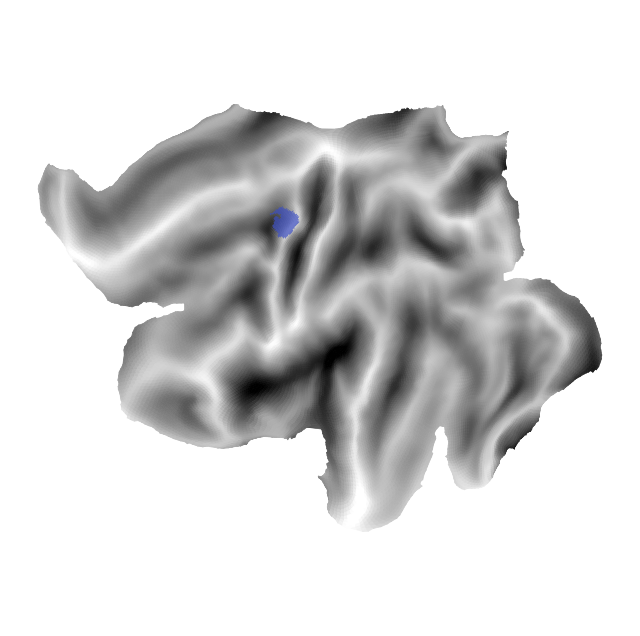

/Users/aghavamp/Desktop/Projects/SUITPy/SUITPy/flatmap.py:354: RuntimeWarning: invalid value encountered in cast
  data_arr = data_arr.astype(int)


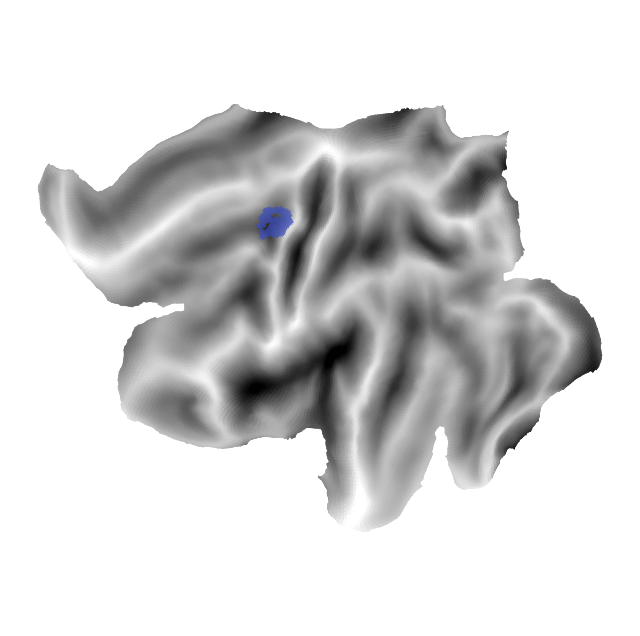

In [15]:
h = 'L'
sn = 101

S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))

S.center_indx
S.voxel_indx
voxlist = S.voxlist

vertices = [5758, 5961]

template_nii_path = os.path.join(baseDir, 'glmsingle', f's{sn}', 'mask.nii')
mask = nb.load(template_nii_path)
sz = mask.shape
affine = mask.affine

for vert in vertices:
    center_mask = np.zeros(sz)
    searchlight = np.transpose(S.voxel_indx[:, voxlist[vert]])
    for i, j, k in searchlight:
        center_mask[i, j, k] = 1

    center_nii = nb.Nifti1Image(center_mask, affine=affine)
    nb.save(center_nii, os.path.join(baseDir, 'searchlight', f'center_s{sn}_{h}_{vert}.nii'))

# project search light to surf:
surf_white = os.path.join(baseDir,surfacewbDir, f's{sn}', f's{sn}.{h}.white.32k.surf.gii')
surf_pial = os.path.join(baseDir,surfacewbDir, f's{sn}', f's{sn}.{h}.pial.32k.surf.gii')
surf_sulc = os.path.join(baseDir,surfacewbDir, f's{sn}', f's{sn}.{h}.sulc.32k.shape.gii')

for vert in vertices:
    # Map a Nifti to the surface of left hemisphere
    DL = surf.map.vol_to_surf([os.path.join(baseDir, 'searchlight', f'center_s{sn}_{h}_{vert}.nii')], surf_pial, surf_white, stats='mode')

    fig, axs = plt.subplots(figsize=(8, 8))
    surf.plot.plotmap(DL, f'fs32k_L',
                        underlay=None,
                        underscale=[-1.5, 1],
                        alpha=.7,
                        cmap='coolwarm',
                        overlay_type='label'
                        )
    plt.show()


